In [26]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

In [3]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [4]:
ruta_train = './data/train_set.csv'
ruta_test = './data/test_set.csv'
ruta_y_pred = './data/sample_submission.csv'
df_train= pd.read_csv(ruta_train, sep = ',')
df_test = pd.read_csv(ruta_test, sep = ',')
df_y_test = pd.read_csv(ruta_y_pred, sep = ',')

C:\Users\Michael_PC\AppData\Local\Temp\ipykernel_16032\3184755546.py:4: DtypeWarning: Columns (8) have mixed types. Specify dtype option on import or set low_memory=False.
  df_train= pd.read_csv(ruta_train, sep = ',')
C:\Users\Michael_PC\AppData\Local\Temp\ipykernel_16032\3184755546.py:5: DtypeWarning: Columns (8) have mixed types. Specify dtype option on import or set low_memory=False.
  df_test = pd.read_csv(ruta_test, sep = ',')


In [5]:
df_train.head()

,trip_id,duration,start_time,end_time,start_lat,start_lon,end_lat,end_lon,bike_id,plan_duration,trip_route_category,passholder_type,start_station,end_station
0,101750280,35,2018-08-07 11:20:00,2018-08-07 11:55:00,33.748920,-118.275192,33.748920,-118.275192,06530,1.0,Round Trip,Walk-up,4127,4127
1,46560345,32,9/17/2017 17:51,9/17/2017 18:23,34.035679,-118.270813,34.047749,-118.243172,6683,0.0,One Way,Walk-up,3057,3062
2,120016336,6,2019-04-22 09:22:00,2019-04-22 09:28:00,34.046070,-118.233093,34.047749,-118.243172,06710,30.0,One Way,Monthly Pass,3022,3062
3,129547190,138,9/22/2019 11:27,9/22/2019 13:45,34.062580,-118.290092,34.059689,-118.294662,17068,1.0,One Way,One Day Pass,4304,4311
4,136619463,14,1/31/2020 17:11,1/31/2020 17:25,34.026291,-118.277687,34.021660,-118.278687,18841,30.0,One Way,Monthly Pass,4266,4443


In [6]:
df_test.head()

,trip_id,duration,start_time,end_time,start_lat,start_lon,end_lat,end_lon,bike_id,trip_route_category,start_station,end_station
0,17059130,12,1/1/2017 0:24,1/1/2017 0:36,34.058319,-118.246094,34.058319,-118.246094,6351,Round Trip,3028,3028
1,17059129,17,1/1/2017 0:28,1/1/2017 0:45,34.049980,-118.247162,34.043732,-118.260139,5836,One Way,3027,3018
2,17059126,20,1/1/2017 0:39,1/1/2017 0:59,34.063389,-118.236160,34.044159,-118.251579,6529,One Way,3066,3055
3,17059125,12,1/1/2017 0:43,1/1/2017 0:55,34.048851,-118.246422,34.050140,-118.233238,6029,One Way,3029,3079
4,17061379,48,1/1/2017 0:56,1/1/2017 1:44,34.049198,-118.252831,34.049198,-118.252831,6680,Round Trip,3063,3063


In [7]:
df_train.shape, df_test.shape

((700000, 14), (569886, 12))

#### Columnas que están en el df_train y que no están en df_test

In [8]:
set(df_train.columns) - set(df_test.columns)

{'passholder_type', 'plan_duration'}

### adicionando la variable objetivo al conjunto de testeo

In [9]:
df_test = pd.merge(df_test, df_y_test, on = 'trip_id', how = 'inner')
df_test.head()

,trip_id,duration,start_time,end_time,start_lat,start_lon,end_lat,end_lon,bike_id,trip_route_category,start_station,end_station,passholder_type
0,17059130,12,1/1/2017 0:24,1/1/2017 0:36,34.058319,-118.246094,34.058319,-118.246094,6351,Round Trip,3028,3028,Monthly Pass
1,17059129,17,1/1/2017 0:28,1/1/2017 0:45,34.049980,-118.247162,34.043732,-118.260139,5836,One Way,3027,3018,Monthly Pass
2,17059126,20,1/1/2017 0:39,1/1/2017 0:59,34.063389,-118.236160,34.044159,-118.251579,6529,One Way,3066,3055,Monthly Pass
3,17059125,12,1/1/2017 0:43,1/1/2017 0:55,34.048851,-118.246422,34.050140,-118.233238,6029,One Way,3029,3079,Monthly Pass
4,17061379,48,1/1/2017 0:56,1/1/2017 1:44,34.049198,-118.252831,34.049198,-118.252831,6680,Round Trip,3063,3063,Monthly Pass


#### Uniendo los dataset df_train, df_test con el fin de realizar el análisis exploratorio de datos

In [10]:
df = pd.concat([df_train, df_test], axis = 0, join = 'outer')
print(df.shape)
df.head()

(1269886, 14)


,trip_id,duration,start_time,end_time,start_lat,start_lon,end_lat,end_lon,bike_id,plan_duration,trip_route_category,passholder_type,start_station,end_station
0,101750280,35,2018-08-07 11:20:00,2018-08-07 11:55:00,33.748920,-118.275192,33.748920,-118.275192,06530,1.0,Round Trip,Walk-up,4127,4127
1,46560345,32,9/17/2017 17:51,9/17/2017 18:23,34.035679,-118.270813,34.047749,-118.243172,6683,0.0,One Way,Walk-up,3057,3062
2,120016336,6,2019-04-22 09:22:00,2019-04-22 09:28:00,34.046070,-118.233093,34.047749,-118.243172,06710,30.0,One Way,Monthly Pass,3022,3062
3,129547190,138,9/22/2019 11:27,9/22/2019 13:45,34.062580,-118.290092,34.059689,-118.294662,17068,1.0,One Way,One Day Pass,4304,4311
4,136619463,14,1/31/2020 17:11,1/31/2020 17:25,34.026291,-118.277687,34.021660,-118.278687,18841,30.0,One Way,Monthly Pass,4266,4443


#### Datos nulos

In [11]:
df_train.isnull().sum()

trip_id                    0
duration                   0
start_time                 0
end_time                   0
start_lat               5563
start_lon               5563
end_lat                18574
end_lon                18574
bike_id                    0
plan_duration            208
trip_route_category        0
passholder_type         2576
start_station              0
end_station                0
dtype: int64

In [12]:
df_test.isnull().sum()

trip_id                    0
duration                   0
start_time                 0
end_time                   0
start_lat               4622
start_lon               4622
end_lat                14891
end_lon                14891
bike_id                    0
trip_route_category        0
start_station              0
end_station                0
passholder_type            0
dtype: int64

In [13]:
df.isnull().sum()/df.shape[0]

trip_id                0.000000
duration               0.000000
start_time             0.000000
end_time               0.000000
start_lat              0.008020
start_lon              0.008020
end_lat                0.026353
end_lon                0.026353
bike_id                0.000000
plan_duration          0.448933
trip_route_category    0.000000
passholder_type        0.002029
start_station          0.000000
end_station            0.000000
dtype: float64

#### Convertir las variables start_time y end_time a fecha

In [14]:
df_train['start_time'].value_counts()

start_time
2018-10-03 09:29:00    12
2017-10-08 14:12:00     8
2018-06-25 18:30:00     8
2017-10-08 18:06:00     7
5/23/2020 15:50         7
2018-07-20 13:45:00     7
2018-09-30 10:36:00     7
2018-10-03 11:13:00     7
7/16/2017 18:06         7
3/20/2021 13:55         7
2018-09-30 14:45:00     7
2018-05-01 19:20:00     7
2018-09-30 14:00:00     7
2019-03-03 13:15:00     7
3/19/2017 16:32         7
2018-09-30 09:49:00     7
2018-03-15 16:28:00     7
2018-09-30 11:50:00     7
2017-10-08 13:54:00     7
2018-12-02 13:48:00     7
2018-12-02 12:12:00     7
2/6/2021 13:26          6
1/10/2020 15:18         6
2018-09-30 14:40:00     6
2018-07-23 19:40:00     6
5/30/2021 12:46         6
2016-10-07 13:38:00     6
2016-10-07 12:52:00     6
2016-10-16 15:34:00     6
2018-09-20 14:21:00     6
9/5/2019 17:46          6
1/26/2020 13:48         6
2018-02-03 16:05:00     6
7/30/2017 20:14         6
2018-03-24 14:44:00     6
9/27/2017 18:09         6
2018-07-09 17:09:00     6
2017-10-08 10:59:00     6
2

#### Preprocesando la variable start_time y end_time

In [15]:
df_train['start_time'] = pd.to_datetime(df_train['start_time'],
                                        format = 'mixed')
df_train['end_time'] = pd.to_datetime(df_train['end_time'],
                                        format = 'mixed')
df_test['start_time'] = pd.to_datetime(df_test['start_time'],
                                        format = 'mixed')
df_test['end_time'] = pd.to_datetime(df_test['end_time'],
                                        format = 'mixed')
df['start_time'] = pd.to_datetime(df['start_time'],
                                        format = 'mixed')
df['end_time'] = pd.to_datetime(df['end_time'],
                                        format = 'mixed')

In [16]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700000 entries, 0 to 699999
Data columns (total 14 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   trip_id              700000 non-null  int64         
 1   duration             700000 non-null  int64         
 2   start_time           700000 non-null  datetime64[ns]
 3   end_time             700000 non-null  datetime64[ns]
 4   start_lat            694437 non-null  float64       
 5   start_lon            694437 non-null  float64       
 6   end_lat              681426 non-null  float64       
 7   end_lon              681426 non-null  float64       
 8   bike_id              700000 non-null  object        
 9   plan_duration        699792 non-null  float64       
 10  trip_route_category  700000 non-null  object        
 11  passholder_type      697424 non-null  object        
 12  start_station        700000 non-null  int64         
 13  end_station   

In [17]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569886 entries, 0 to 569885
Data columns (total 13 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   trip_id              569886 non-null  int64         
 1   duration             569886 non-null  int64         
 2   start_time           569886 non-null  datetime64[ns]
 3   end_time             569886 non-null  datetime64[ns]
 4   start_lat            565264 non-null  float64       
 5   start_lon            565264 non-null  float64       
 6   end_lat              554995 non-null  float64       
 7   end_lon              554995 non-null  float64       
 8   bike_id              569886 non-null  object        
 9   trip_route_category  569886 non-null  object        
 10  start_station        569886 non-null  int64         
 11  end_station          569886 non-null  int64         
 12  passholder_type      569886 non-null  object        
dtypes: datetime64[

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1269886 entries, 0 to 569885
Data columns (total 14 columns):
 #   Column               Non-Null Count    Dtype         
---  ------               --------------    -----         
 0   trip_id              1269886 non-null  int64         
 1   duration             1269886 non-null  int64         
 2   start_time           1269886 non-null  datetime64[ns]
 3   end_time             1269886 non-null  datetime64[ns]
 4   start_lat            1259701 non-null  float64       
 5   start_lon            1259701 non-null  float64       
 6   end_lat              1236421 non-null  float64       
 7   end_lon              1236421 non-null  float64       
 8   bike_id              1269886 non-null  object        
 9   plan_duration        699792 non-null   float64       
 10  trip_route_category  1269886 non-null  object        
 11  passholder_type      1267310 non-null  object        
 12  start_station        1269886 non-null  int64         
 13  end

### Pregunta
* Saturación del servicio: La empresa busca contar con la disponibilidad más alta
de servicio en el mercado, por lo que se quiere entender cómo se comporta la
demanda de servicio en las distintas estaciones y horarios para cada plan.

#### Adicionando las variables de día, mes, hora para cada una de las variables "start_time" y "end_time"

Se crean estas variables con el fin de realizar un mejor análisis exploratorio de datos

In [19]:
# Extrayendo los componente de 'start_time'
df['start_day'] = df['start_time'].dt.day
df['start_month'] = df['start_time'].dt.month
df['start_year'] = df['start_time'].dt.year
df['start_hour'] = df['start_time'].dt.hour
df['start_minute'] = df['start_time'].dt.minute
df['start_second'] = df['start_time'].dt.second

# Extrayendo los componentes de 'end_time'
df['end_day'] = df['end_time'].dt.day
df['end_month'] = df['end_time'].dt.month
df['end_year'] = df['end_time'].dt.year
df['end_hour'] = df['end_time'].dt.hour
df['end_minute'] = df['end_time'].dt.minute
df['end_second'] = df['end_time'].dt.second

In [20]:
df.head()

,trip_id,duration,start_time,end_time,start_lat,start_lon,end_lat,end_lon,bike_id,plan_duration,trip_route_category,passholder_type,start_station,end_station,start_day,start_month,start_year,start_hour,start_minute,start_second,end_day,end_month,end_year,end_hour,end_minute,end_second
0,101750280,35,2018-08-07 11:20:00,2018-08-07 11:55:00,33.748920,-118.275192,33.748920,-118.275192,06530,1.0,Round Trip,Walk-up,4127,4127,7,8,2018,11,20,0,7,8,2018,11,55,0
1,46560345,32,2017-09-17 17:51:00,2017-09-17 18:23:00,34.035679,-118.270813,34.047749,-118.243172,6683,0.0,One Way,Walk-up,3057,3062,17,9,2017,17,51,0,17,9,2017,18,23,0
2,120016336,6,2019-04-22 09:22:00,2019-04-22 09:28:00,34.046070,-118.233093,34.047749,-118.243172,06710,30.0,One Way,Monthly Pass,3022,3062,22,4,2019,9,22,0,22,4,2019,9,28,0
3,129547190,138,2019-09-22 11:27:00,2019-09-22 13:45:00,34.062580,-118.290092,34.059689,-118.294662,17068,1.0,One Way,One Day Pass,4304,4311,22,9,2019,11,27,0,22,9,2019,13,45,0
4,136619463,14,2020-01-31 17:11:00,2020-01-31 17:25:00,34.026291,-118.277687,34.021660,-118.278687,18841,30.0,One Way,Monthly Pass,4266,4443,31,1,2020,17,11,0,31,1,2020,17,25,0


In [24]:
grupo_anio = df.groupby(['passholder_type', 
                  'start_station',
                  'end_station',
                  'start_year',
                  'end_year']
                  ).size()
grupo_anio_ordenado = grupo_anio.sort_values(ascending = False).to_frame().reset_index()
grupo_anio_ordenado.rename(columns = {0:'cantidad_de_viajes'}, inplace = True)
grupo_anio_ordenado.head()

,passholder_type,start_station,end_station,start_year,end_year,cantidad_de_viajes
0,Monthly Pass,3030,3014,2019,2019,5059
1,Monthly Pass,3014,3030,2019,2019,4340
2,Walk-up,4214,4214,2018,2018,3804
3,Monthly Pass,4214,4214,2018,2018,3493
4,Monthly Pass,3030,3014,2018,2018,2755


In [29]:
grupo_anio_ordenado.shape

(102415, 6)

### Frecuencia de estaciones con respecto al plan

In [33]:
cant_viajes_passholder_start_station = grupo_anio_ordenado.groupby(
    ['passholder_type', 'start_station']
    )['cantidad_de_viajes'
      ].sum().to_frame().reset_index().sort_values(
          by = 'cantidad_de_viajes', ascending = False)
cant_viajes_passholder_start_station.shape

(1546, 3)

In [34]:
cant_viajes_passholder_start_station

,passholder_type,start_station,cantidad_de_viajes
436,Monthly Pass,3005,43885
457,Monthly Pass,3030,32712
444,Monthly Pass,3014,28374
458,Monthly Pass,3031,26276
462,Monthly Pass,3035,23209
486,Monthly Pass,3064,23061
437,Monthly Pass,3006,19225
500,Monthly Pass,3082,18700
468,Monthly Pass,3042,18320
489,Monthly Pass,3067,18102


### Creando un grafo

In [27]:
# Initialize an empty graph
G = nx.Graph()

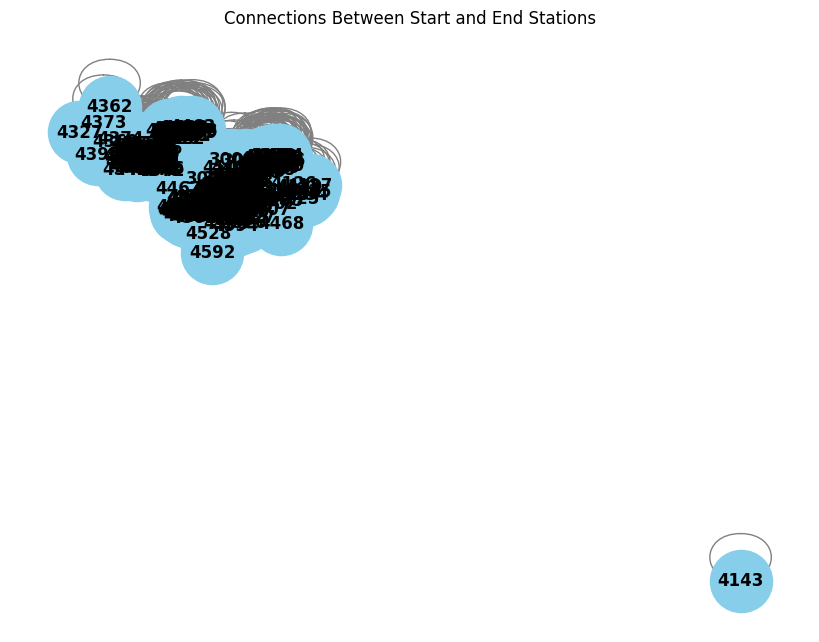

In [28]:
# Add edges between start and end stations
for _, row in df.iterrows():
    G.add_edge(row['start_station'], row['end_station'])

# Draw the graph
plt.figure(figsize=(8, 6))
nx.draw(G, with_labels=True, node_size=2000, node_color='skyblue', font_size=12, font_weight='bold', edge_color='gray')
plt.title("Connections Between Start and End Stations")
plt.show()